## 📦 Load Packages


In [2]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from shapely.geometry import Point


## 📂 Load Data


### Counties Data


In [5]:
# Load full U.S. counties file from TIGER shapefile
path = "../data/tl_2023_us_county/tl_2023_us_county.shp"
gdf_all = gpd.read_file(path)

# California FIPS state code is '06'
gdf_california = gdf_all[gdf_all['STATEFP'] == '06']

# Save filtered data
gdf_california.to_file("../output/california_counties.geojson", driver="GeoJSON")

# Show first 5 rows
gdf_california.head(5)


,STATEFP,COUNTYFP,COUNTYNS,GEOID,GEOIDFQ,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
8,06,091,00277310,06091,0500000US06091,Sierra,Sierra County,06,H1,G4020,None,None,None,A,2468694578,23299110,+39.5769252,-120.5219926,"POLYGON ((-120.55587 39.50874, -120.55614 39.5..."
324,06,067,00277298,06067,0500000US06067,Sacramento,Sacramento County,06,H1,G4020,472,40900,None,A,2500063005,75323439,+38.4501363,-121.3443291,"POLYGON ((-121.43991 38.25553, -121.44002 38.2..."
328,06,083,00277306,06083,0500000US06083,Santa Barbara,Santa Barbara County,06,H1,G4020,None,42200,None,A,7080874935,2729198796,+34.5366774,-120.0383645,"MULTIPOLYGON (((-120.58226 34.10752, -120.5790..."
345,06,009,01675885,06009,0500000US06009,Calaveras,Calaveras County,06,H1,G4020,None,None,None,A,2641829627,43797225,+38.1910682,-120.5541065,"POLYGON ((-120.6318 38.34603, -120.63066 38.34..."
393,06,111,00277320,06111,0500000US06111,Ventura,Ventura County,06,H1,G4020,348,37100,None,A,4767585000,947376202,+34.3587477,-119.1331453,"MULTIPOLYGON (((-119.63607 33.28071, -119.6348..."


In [6]:
# Rename the 'NAME' column to 'county' for clarity and consistency in downstream merges and visualizations
gdf_california = gdf_california.rename(columns={'NAME': 'county'})

# Display updated column names to confirm the rename
gdf_california.columns


Index(['STATEFP', 'COUNTYFP', 'COUNTYNS', 'GEOID', 'GEOIDFQ', 'county',
       'NAMELSAD', 'LSAD', 'CLASSFP', 'MTFCC', 'CSAFP', 'CBSAFP', 'METDIVFP',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry'],
      dtype='object')

In [7]:
# Filter California counties to check if "San Francisco" is present in the 'county' column (case-insensitive)
gdf_california[gdf_california['county'].str.contains('San Francisco', case=False)]


,STATEFP,COUNTYFP,COUNTYNS,GEOID,GEOIDFQ,county,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
635,06,075,00277302,06075,0500000US06075,San Francisco,San Francisco County,06,H6,G4020,488,41860,41884,C,120951669,479702222,+37.7272391,-123.0322294,"MULTIPOLYGON (((-122.40536 37.70826, -122.4054..."


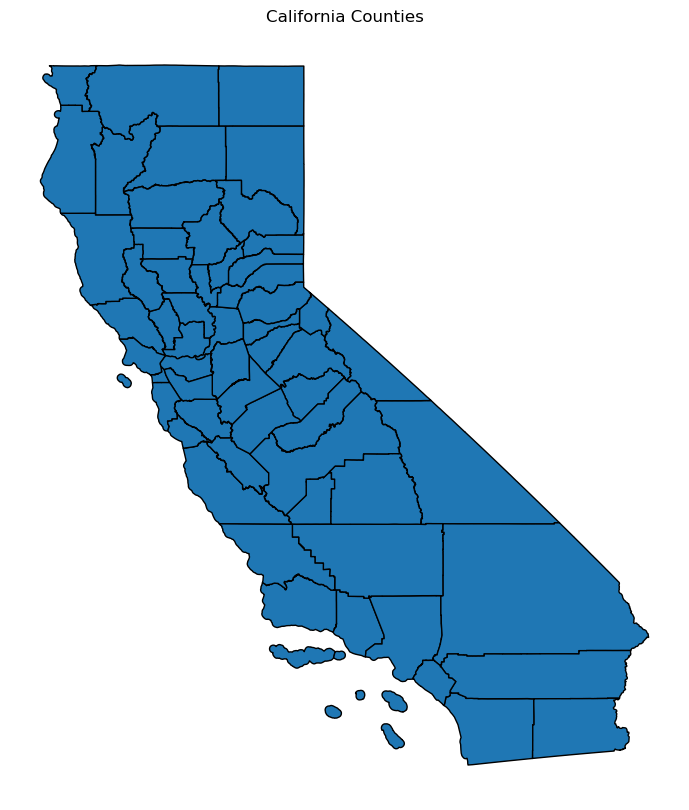

In [8]:
# Plot the counties
gdf_california.plot(edgecolor='black', figsize=(10, 10))
plt.title("California Counties")
plt.axis('off')
plt.show()


### Earthquake Data


In [10]:
# Load earthquake data
eq_path = "../data/earthquakes.csv"
df_eq = pd.read_csv(eq_path)

# Show the first few rows
df_eq.head()


,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,2025-07-11T09:55:42.860Z,33.160833,-115.636667,11.21,4.34,mw,79.0,41.00,0.02421,0.2500,...,2025-07-27T10:05:57.781Z,"12 km WNW of Calipatria, CA",earthquake,0.20,0.47,NaN,6.0,reviewed,ci,ci
1,2025-06-29T02:37:58.310Z,37.316000,-117.920667,11.60,4.54,mw,65.0,69.00,0.30130,0.1000,...,2025-07-29T03:01:34.705Z,"8 km SSE of Deep Springs, CA",earthquake,0.23,0.57,NaN,12.0,reviewed,nc,nc
2,2025-06-13T07:44:47.750Z,40.334167,-124.881000,8.99,4.08,mw,185.0,230.00,0.41420,0.3000,...,2025-07-09T10:32:58.758Z,"51 km WNW of Petrolia, CA",earthquake,0.47,0.74,NaN,14.0,reviewed,nc,nc
3,2025-06-06T07:16:12.812Z,37.266000,-114.642400,4.30,4.00,mw,12.0,87.08,0.35400,0.1596,...,2025-07-25T07:26:23.180Z,"40 km SSW of Caliente, Nevada",earthquake,NaN,4.10,NaN,NaN,reviewed,nn,nn
4,2025-05-26T08:17:57.630Z,40.265500,-124.637000,2.92,4.63,mw,78.0,230.00,0.25960,0.2600,...,2025-07-09T21:47:02.991Z,"31 km W of Petrolia, CA",earthquake,0.53,0.90,NaN,12.0,reviewed,nc,nc


In [11]:
# Count the total number of earthquakes (Magnitude ≥ 4.0) recorded in California from 1769 to 2025
print("Total earthquakes:", df_eq.shape[0])

# Magnitude stats
df_eq['mag'].describe()


Total earthquakes: 5109


count    5109.000000
mean        4.538992
std         0.558043
min         4.000000
25%         4.140000
50%         4.380000
75%         4.700000
max         7.930000
Name: mag, dtype: float64

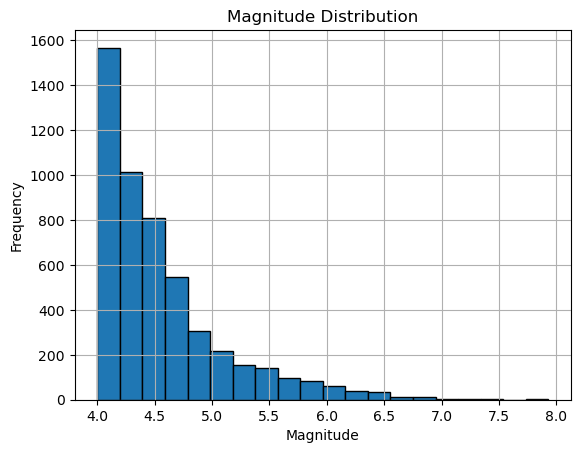

In [12]:
# Plot a histogram of earthquake magnitudes (≥ 4.0) to visualize how frequently different magnitudes occur in the dataset
plt.hist(df_eq['mag'], bins=20, edgecolor='black')
plt.title("Magnitude Distribution")
plt.xlabel("Magnitude")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()


## 🧼 Clean Data


In [14]:
# Convert 'time' column to datetime format for easier filtering and plotting
df_eq['time'] = pd.to_datetime(df_eq['time'])


In [15]:
# Check for missing values in each column
df_eq.isnull().sum()


time                  0
latitude              0
longitude             0
depth               591
mag                   0
magType               0
nst                1287
gap                1293
dmin               2170
rms                1232
net                   0
id                    0
updated               0
place                 0
type                  0
horizontalError    2069
depthError         1417
magError           3168
magNst             1116
status                0
locationSource        0
magSource             0
dtype: int64

In [16]:
# Create geometry column using latitude and longitude for geospatial operations
geometry = [Point(xy) for xy in zip(df_eq['longitude'], df_eq['latitude'])]
gdf_eq = gpd.GeoDataFrame(df_eq, geometry=geometry, crs="EPSG:4326")


## 🌍 Spatial Join


In [18]:
# Ensure the county GeoDataFrame uses the standard WGS84 coordinate system (EPSG:4326)
# This is required for accurate spatial joins with earthquake data
gdf_california = gdf_california.to_crs("EPSG:4326")
print(gdf_california.crs)


EPSG:4326


In [19]:
# Spatial join: assign each earthquake to a county
gdf_joined = gpd.sjoin(gdf_eq, gdf_california, how="inner", predicate="within")


In [20]:
# Save joined data for reuse
gdf_joined.to_file("../output/earthquakes_joined.geojson", driver="GeoJSON")
gdf_joined.drop(columns='geometry').to_csv("../output/earthquakes_joined.csv", index=False)


In [21]:
# Check if the 1906 San Francisco earthquake (April 18, 1906) was successfully included in the spatially joined dataset
gdf_joined[gdf_joined['time'].dt.date == pd.to_datetime("1906-04-18").date()]


,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON
4951,1906-04-18 13:12:26.300000+00:00,37.75,-122.55,11.7,7.9,mw,NaN,NaN,NaN,NaN,...,H6,G4020,488,41860,41884,C,120951669,479702222,+37.7272391,-123.0322294


In [22]:
# Display the column names of the joined GeoDataFrame to inspect available attributes
gdf_joined.columns


Index(['time', 'latitude', 'longitude', 'depth', 'mag', 'magType', 'nst',
       'gap', 'dmin', 'rms', 'net', 'id', 'updated', 'place', 'type',
       'horizontalError', 'depthError', 'magError', 'magNst', 'status',
       'locationSource', 'magSource', 'geometry', 'index_right', 'STATEFP',
       'COUNTYFP', 'COUNTYNS', 'GEOID', 'GEOIDFQ', 'county', 'NAMELSAD',
       'LSAD', 'CLASSFP', 'MTFCC', 'CSAFP', 'CBSAFP', 'METDIVFP', 'FUNCSTAT',
       'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON'],
      dtype='object')

In [23]:
# Preview the first few rows with selected columns to inspect earthquake details and assigned county
gdf_joined[['time', 'mag', 'place', 'county']].head()


,time,mag,place,county
0,2025-07-11 09:55:42.860000+00:00,4.34,"12 km WNW of Calipatria, CA",Imperial
1,2025-06-29 02:37:58.310000+00:00,4.54,"8 km SSE of Deep Springs, CA",Inyo
7,2025-04-14 17:08:28.110000+00:00,5.21,"5 km S of Julian, CA",San Diego
9,2025-03-17 02:13:44.980000+00:00,4.18,"9 km NNE of Lake Pillsbury, CA",Lake
10,2025-03-09 20:03:20.340000+00:00,4.06,"10 km NW of Malibu, CA",Los Angeles


In [24]:
# Count earthquakes by county
gdf_joined['county'].value_counts().head(10)


county
San Bernardino    509
Mono              374
Kern              354
Imperial          317
Inyo              204
Los Angeles       194
San Benito        186
Riverside         166
Humboldt          145
Fresno            115
Name: count, dtype: int64

## 📊 Exploratory Data Analysis (EDA)


### 1. All Earthquakes (Magnitude ≥ 4.0) — Clustered Interactive Map
*This interactive map uses marker clustering to visualize all recorded earthquakes in California (Magnitude ≥ 4.0), helping highlight densely affected areas without visual overlap.*

⚠️ Note: Interactive Folium maps do not render in GitHub Notebooks.  
👉 [Click here to view the full map](https://annapiter.github.io/earthquake-insurance-analysis/all_quakes_clustered_map.html)


In [27]:
from folium.plugins import MarkerCluster

# Create base map centered on California
m_cluster = folium.Map(location=[37.5, -119.5], zoom_start=6)

# Add clustering
marker_cluster = MarkerCluster().add_to(m_cluster)

# Add earthquake markers
for _, row in df_eq.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"M {row['mag']} | {row['place']}"
    ).add_to(marker_cluster)

# Show the map
m_cluster


### 2. Strong Earthquakes (Magnitude ≥ 6.0)


In [29]:
# Filter strong earthquakes (Mag ≥ 6.0)
strong_quakes = gdf_joined[gdf_joined['mag'] >= 6.0]

# Count of strong earthquakes per county
strong_quake_counts = strong_quakes['county'].value_counts()

# Preview top 10 counties with most strong earthquakes
strong_quake_counts.head(10)


county
San Bernardino     12
Humboldt           11
Inyo                8
Santa Clara         8
San Benito          8
Imperial            7
Mono                7
Riverside           6
San Diego           6
San Luis Obispo     5
Name: count, dtype: int64

### 3. Strong Earthquakes by County (Static Map)
*This choropleth provides a quick visual of where strong earthquakes (Mag ≥ 6.0) occur most often.*


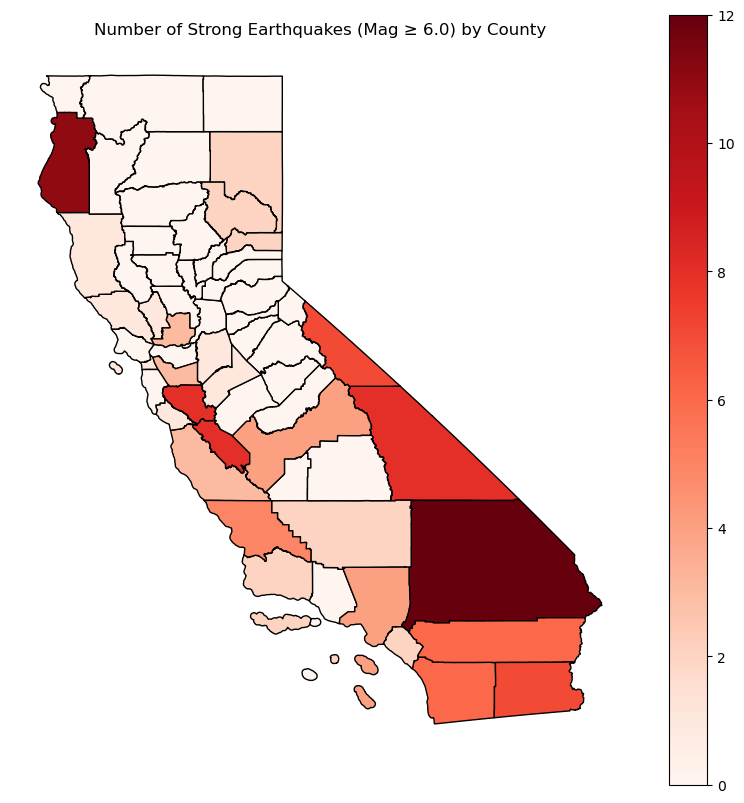

In [31]:
# Merge strong quake counts into California counties GeoDataFrame
gdf_quake_map = gdf_california.merge(strong_quake_counts, how='left', left_on='county', right_index=True)
gdf_quake_map['count'] = gdf_quake_map['county'].map(strong_quake_counts).fillna(0)

# Choropleth: Strong Earthquake Frequency
gdf_quake_map.plot(column='count', cmap='Reds', legend=True, edgecolor='black', figsize=(10, 10))
plt.title("Number of Strong Earthquakes (Mag ≥ 6.0) by County")
plt.axis('off')
plt.show()


### 4. Interactive Map: Strong Earthquake Counts by County (Magnitude ≥ 6.0)
*Hover over each California county to see how many strong earthquakes (magnitude ≥ 6.0) have occurred there. This helps highlight high-risk regions for major seismic events.*

> ⚠️ *Note: Interactive Folium maps do not render in GitHub Notebooks.*  
> 👉 [Click here to view the Strong Earthquakes interactive map](https://annapiter.github.io/earthquake-insurance-analysis/strong_quakes_map.html)


In [33]:
from folium.features import GeoJsonTooltip

# Convert to GeoJSON-like format
gdf_quake_map = gdf_quake_map.to_crs("EPSG:4326")

# Create base map
m_strong = folium.Map(location=[37.5, -119.5], zoom_start=6, tiles="cartodbpositron")

# Add choropleth with tooltips
folium.GeoJson(
    gdf_quake_map,
    name="Strong Quakes",
    style_function=lambda x: {
        'fillColor': '#ff6347',
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0.7,
    },
    tooltip=GeoJsonTooltip(
        fields=["county", "count"],
        aliases=["County", "Strong Quakes (≥6.0)"],
        sticky=True
    )
).add_to(m_strong)

# Show the map
m_strong


### 5. Top Earthquakes and Max Magnitude by County


In [35]:
# Top 10 strongest earthquakes across California (by magnitude)
top_quakes = gdf_joined.sort_values(by="mag", ascending=False)
top_quakes[['time', 'mag', 'place', 'county']].head(10)


,time,mag,place,county
5078,1857-01-09 16:24:00+00:00,7.93,"The 1857 Fort Tejon, California Earthquake",San Luis Obispo
4951,1906-04-18 13:12:26.300000+00:00,7.90,"The 1906 San Francisco, California Earthquake",San Francisco
4078,1952-07-21 11:52:14.540000+00:00,7.50,"The 1952 Kern County, California Earthquake",Kern
5101,1812-12-08 15:00:00+00:00,7.50,"Northwest of San Bernardino, California",San Bernardino
5095,1838-06-25 20:00:00+00:00,7.40,"The 1838 San Andreas Fault, California Earthquake",Santa Clara
5042,1872-03-26 10:30:00+00:00,7.40,"The 1872 Owens Valley, California Earthquake",Inyo
1611,1992-06-28 11:57:34.130000+00:00,7.30,"The 1992 Landers, California Earthquake",San Bernardino
1660,1992-04-25 18:06:05.180000+00:00,7.20,"The 1992 Petrolia, California Earthquake",Humboldt
1097,1999-10-16 09:46:44.460000+00:00,7.10,"The 1999 Hector Mine, California Earthquake",San Bernardino
376,2019-07-06 03:19:53.040000+00:00,7.10,Ridgecrest Earthquake Sequence,San Bernardino


In [36]:
# Maximum recorded magnitude per county
max_mag_per_county = gdf_joined.groupby('county')['mag'].max().sort_values(ascending=False)

# Preview top 10 counties by max recorded quake
max_mag_per_county.head(10)


county
San Luis Obispo    7.93
San Francisco      7.90
San Bernardino     7.50
Kern               7.50
Santa Clara        7.40
Inyo               7.40
Humboldt           7.20
Imperial           6.90
Santa Cruz         6.90
Alameda            6.80
Name: mag, dtype: float64

### 6. Maximum Earthquake Magnitude by County (Static Map)
*This choropleth shows the strongest earthquake ever recorded in each county. It highlights worst-case seismic risk across the state.*


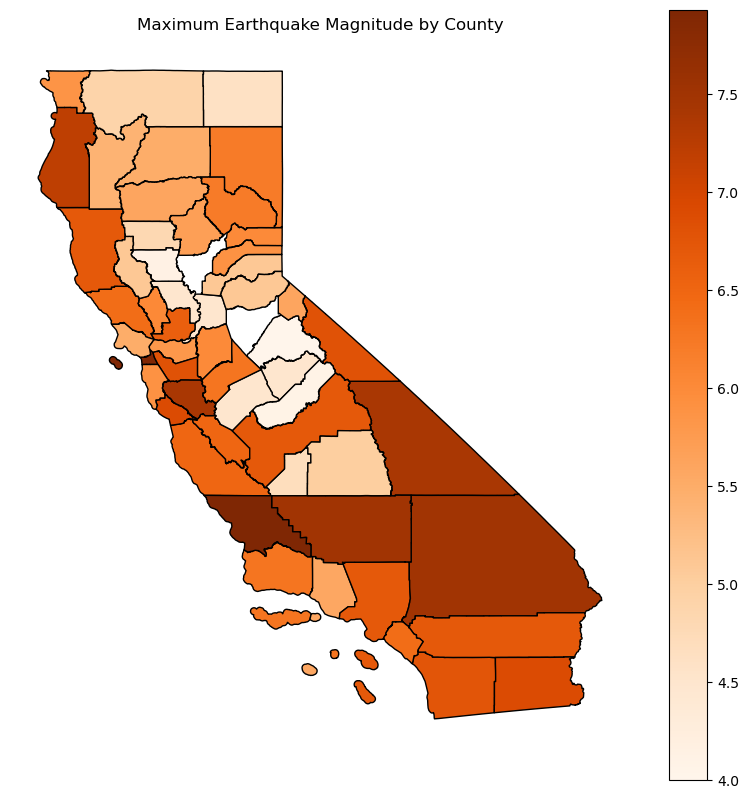

In [38]:
# Calculate max magnitude per county
max_mag_per_county = gdf_joined.groupby('county')['mag'].max()

# Merge with county shapefile
gdf_max_map = gdf_california.merge(max_mag_per_county, how='left', left_on='county', right_index=True)

# Choropleth: Max Magnitude
gdf_max_map.plot(column='mag', cmap='Oranges', legend=True, edgecolor='black', figsize=(10, 10))
plt.title("Maximum Earthquake Magnitude by County")
plt.axis('off')
plt.show()


### 7. Interactive Map: Maximum Earthquake Magnitude by County
*Explore the strongest earthquake ever recorded in each county. Hover over counties to view the maximum magnitude observed historically in that area.*

> ⚠️ *Note: Interactive Folium maps do not render in GitHub Notebooks.*  
> 👉 [Click here to view the Maximum Magnitude interactive map](https://annapiter.github.io/earthquake-insurance-analysis/max_magnitude_map.html)


In [40]:
# Make sure it's in WGS84 (lat/lon)
gdf_max_map = gdf_max_map.to_crs("EPSG:4326")

# Create base map
m_max = folium.Map(location=[37.5, -119.5], zoom_start=6, tiles="cartodbpositron")

# Add GeoJson with tooltips
folium.GeoJson(
    gdf_max_map,
    name="Max Magnitude",
    style_function=lambda x: {
        'fillColor': '#ffa07a',
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0.7,
    },
    tooltip=GeoJsonTooltip(
        fields=["county", "mag"],
        aliases=["County", "Max Magnitude"],
        sticky=True
    )
).add_to(m_max)

# Show the map
m_max


### 8. Average Earthquake Magnitude by County (Static Map)
*This choropleth shows the average magnitude of all recorded earthquakes in each county. It gives insight into chronic seismic activity levels.*


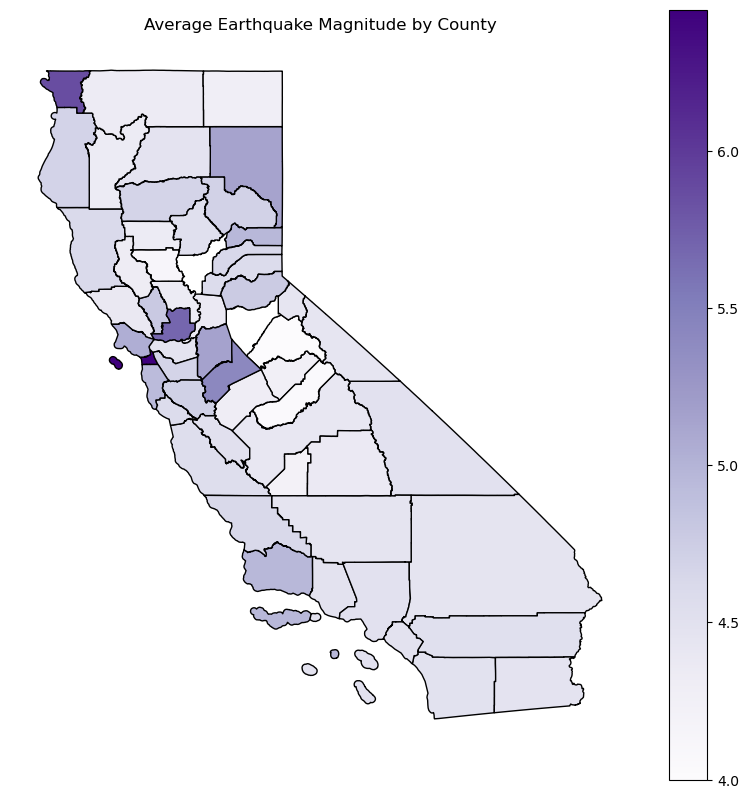

In [42]:
# Calculate average magnitude per county
avg_mag_per_county = gdf_joined.groupby('county')['mag'].mean()

# Merge with county shapefile
gdf_avg_map = gdf_california.merge(avg_mag_per_county, how='left', left_on='county', right_index=True)

# Choropleth: Avg Magnitude
gdf_avg_map.plot(column='mag', cmap='Purples', legend=True, edgecolor='black', figsize=(10, 10))
plt.title("Average Earthquake Magnitude by County")
plt.axis('off')
plt.show()


### 9. Interactive Map: Average Earthquake Magnitude by County
*Hover over each county to see the average magnitude of all recorded earthquakes. This reflects the typical seismic intensity experienced across different regions.*

> ⚠️ *Note: Interactive Folium maps do not render in GitHub Notebooks.*  
> 👉 [Click here to view the Average Magnitude interactive map](https://annapiter.github.io/earthquake-insurance-analysis/avg_magnitude_map.html)


In [44]:
# Make sure projection is right
gdf_avg_map = gdf_avg_map.to_crs("EPSG:4326")

# Create base map
m_avg = folium.Map(location=[37.5, -119.5], zoom_start=6, tiles="cartodbpositron")

# Add GeoJson with tooltips
folium.GeoJson(
    gdf_avg_map,
    name="Avg Magnitude",
    style_function=lambda x: {
        'fillColor': '#9370db',
        'color': 'black',
        'weight': 0.5,
        'fillOpacity': 0.7,
    },
    tooltip=GeoJsonTooltip(
        fields=["county", "mag"],
        aliases=["County", "Average Magnitude"],
        sticky=True
    )
).add_to(m_avg)

# Show the map
m_avg


### 10. Strong Earthquakes per Year (Bar Chart)
*This bar chart shows the number of strong earthquakes (Magnitude ≥ 6.0) in California each year. It reveals short-term variations and spikes in seismic activity.*


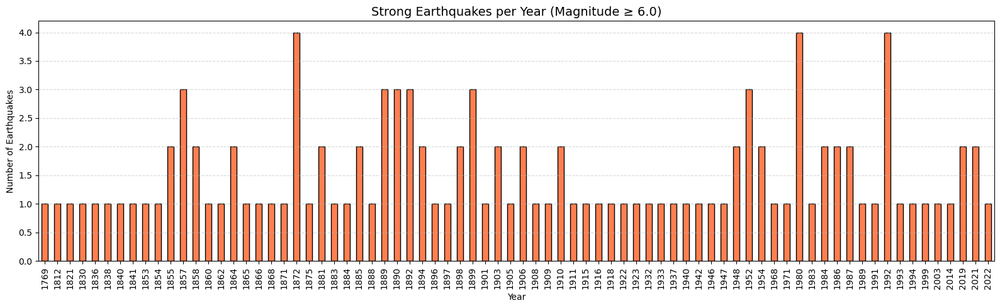

In [46]:
# Create 'year' column
gdf_joined['year'] = gdf_joined['time'].dt.year

# Filter and count strong earthquakes by year
strong_quakes_by_year = gdf_joined[gdf_joined['mag'] >= 6.0]['year'].value_counts().sort_index()

# Plot the yearly frequency of strong earthquakes
plt.figure(figsize=(16, 5))
strong_quakes_by_year.plot(kind='bar', color='coral', edgecolor='black')
plt.title("Strong Earthquakes per Year (Magnitude ≥ 6.0)", fontsize=14)
plt.xlabel("Year")
plt.ylabel("Number of Earthquakes")
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


In [47]:
# Filter strong earthquakes from 2023 through 2025
recent_strong_quakes = gdf_joined[
    (gdf_joined['mag'] >= 6.0) &
    (gdf_joined['time'].dt.year >= 2023)
]

# Display result
recent_strong_quakes[['time', 'mag', 'place', 'county']].sort_values(by='time')


,time,mag,place,county


### 11. Strong Earthquakes by Decade (Line Chart)
*This line plot shows how the number of strong earthquakes (Magnitude ≥ 6.0) changed by decade. It reveals long-term seismic patterns that may be relevant for risk modeling.*


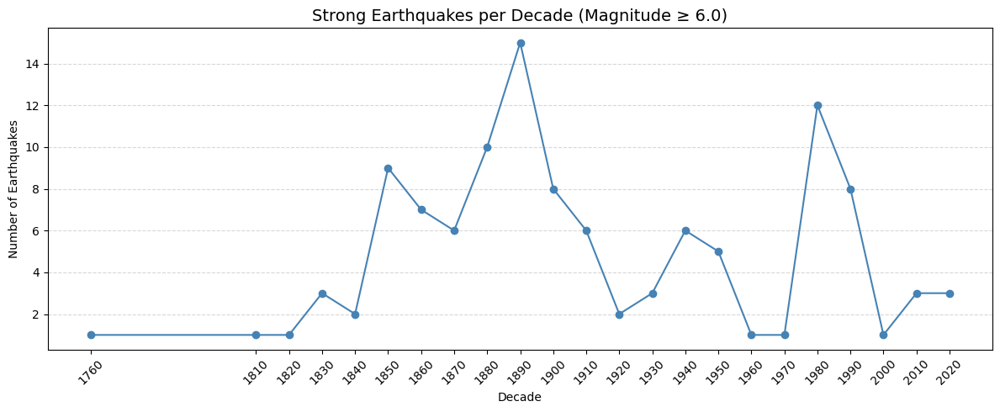

In [49]:
gdf_joined['decade'] = (gdf_joined['year'] // 10) * 10

# Count strong earthquakes per decade
strong_quakes_by_decade = (
    gdf_joined[gdf_joined['mag'] >= 6.0]['decade']
    .value_counts()
    .sort_index()
)

# Plot as line chart
plt.figure(figsize=(12, 5))
plt.plot(
    strong_quakes_by_decade.index,
    strong_quakes_by_decade.values,
    marker='o',
    linestyle='-',
    color='steelblue'
)
plt.title("Strong Earthquakes per Decade (Magnitude ≥ 6.0)", fontsize=14)
plt.xlabel("Decade")
plt.ylabel("Number of Earthquakes")
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.xticks(strong_quakes_by_decade.index, rotation=45)
plt.tight_layout()
plt.show()


### 12. Export Interactive Maps
*Save interactive `.html` maps for sharing or embedding in GitHub README.*


In [51]:
# Save all maps
m_cluster.save("../output/all_earthquakes_clustered.html")
m_strong.save("../output/strong_quakes_map.html")
m_max.save("../output/max_magnitude_map.html")
m_avg.save("../output/avg_magnitude_map.html")


### 13. Summary Table: Earthquake Stats per County


In [53]:
# Summary of quake stats per county
summary_stats = gdf_joined.groupby('county')['mag'].agg(['count', 'mean', 'max']).sort_values('count', ascending=False)
summary_stats.head(10)


,count,mean,max
county,,,
San Bernardino,509,4.454813,7.5
Mono,374,4.435535,6.8
Kern,354,4.450650,7.5
Imperial,317,4.472810,6.9
Inyo,204,4.506814,7.4
Los Angeles,194,4.498866,6.7
San Benito,186,4.509677,6.5
Riverside,166,4.520060,6.7
Humboldt,145,4.684000,7.2
